# **Wine Quality Dataset**

### *Preparing the dataset*

In [38]:
# Import all librabries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from graphviz import Source
from IPython.display import Image, display
import os

In [39]:
# Load the Wine Quality dataset from the CSV file
wine_data = pd.read_csv('winequality-white.csv', delimiter=';')

# Feature columns (Input variables)
X = wine_data.drop(columns=['quality'])

# Output column (Target variable)
y = wine_data['quality']

# 2.1: Grouping quality into categories
def categorize_quality(quality):
    if quality <= 4:
        return 'Low Quality'
    elif quality <= 6:
        return 'Standard Quality'
    else:
        return 'High Quality'

y = y.apply(categorize_quality)

In [40]:
def split_and_visualize(X, y, train_size):
    """
    Splits the dataset into training and test subsets and visualizes class distribution.
    Args:
        X: Features
        y: Labels
        train_size: Proportion of the data to use for training
    Returns:
        feature_train, feature_test, label_train, label_test
    """
    # Perform stratified splitting
    feature_train, feature_test, label_train, label_test = train_test_split(
        X, y, train_size=train_size, stratify=y, random_state=42
    )

    # Visualize class distribution
    train_dist = label_train.value_counts(normalize=True)
    test_dist = label_test.value_counts(normalize=True)

    print(f"Training set distribution (Train size = {train_size}):")
    print(train_dist)
    print(f"Test set distribution (Train size = {train_size}):")
    print(test_dist)

    fig, ax = plt.subplots(1, 2, figsize=(12, 5))
    sns.barplot(x=train_dist.index, y=train_dist.values, ax=ax[0])
    ax[0].set_title("Training Set Distribution")
    sns.barplot(x=test_dist.index, y=test_dist.values, ax=ax[1])
    ax[1].set_title("Test Set Distribution")
    plt.show()

    return feature_train, feature_test, label_train, label_test


--- Train/Test Split: 40/60 ---
Training set distribution (Train size = 0.4):
quality
Standard Quality    0.746299
High Quality        0.216437
Low Quality         0.037264
Name: proportion, dtype: float64
Test set distribution (Train size = 0.4):
quality
Standard Quality    0.746172
High Quality        0.216400
Low Quality         0.037428
Name: proportion, dtype: float64


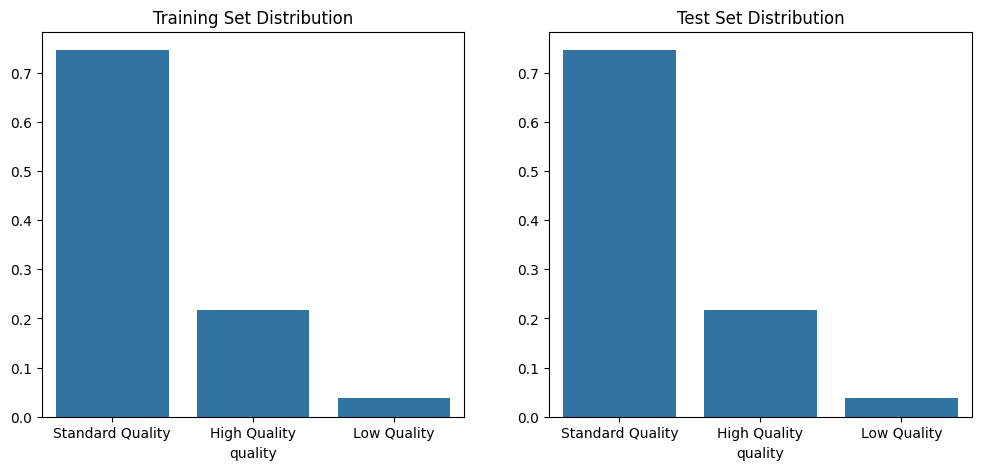


--- Train/Test Split: 60/40 ---
Training set distribution (Train size = 0.6):
quality
Standard Quality    0.746086
High Quality        0.216474
Low Quality         0.037440
Name: proportion, dtype: float64
Test set distribution (Train size = 0.6):
quality
Standard Quality    0.746429
High Quality        0.216327
Low Quality         0.037245
Name: proportion, dtype: float64


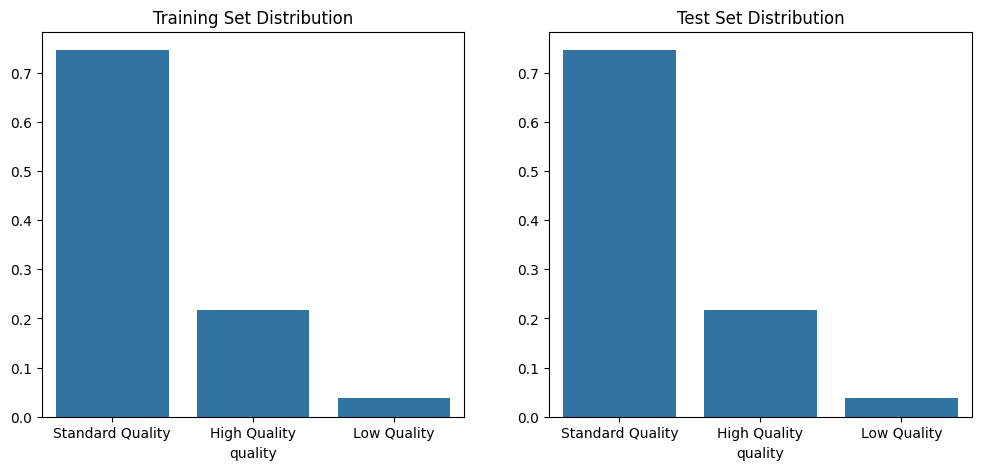


--- Train/Test Split: 80/19 ---
Training set distribution (Train size = 0.8):
quality
Standard Quality    0.746299
High Quality        0.216437
Low Quality         0.037264
Name: proportion, dtype: float64
Test set distribution (Train size = 0.8):
quality
Standard Quality    0.745918
High Quality        0.216327
Low Quality         0.037755
Name: proportion, dtype: float64


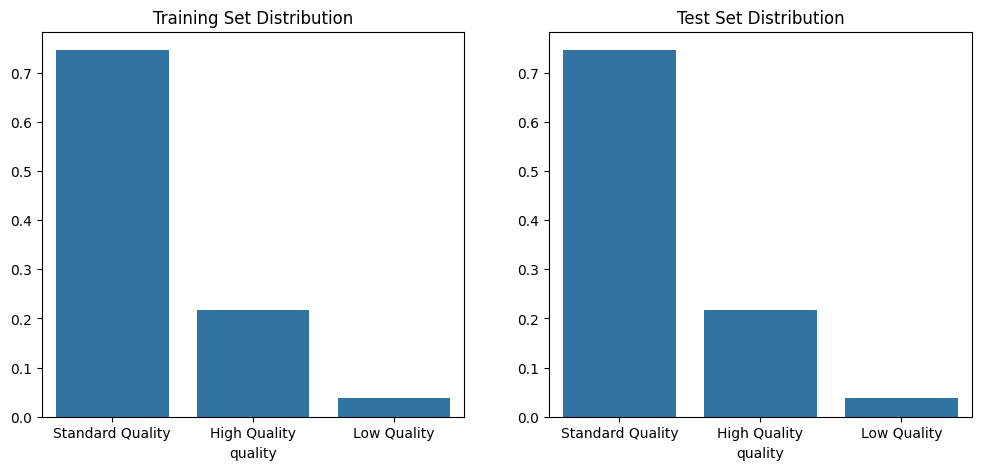


--- Train/Test Split: 90/9 ---
Training set distribution (Train size = 0.9):
quality
Standard Quality    0.746143
High Quality        0.216425
Low Quality         0.037432
Name: proportion, dtype: float64
Test set distribution (Train size = 0.9):
quality
Standard Quality    0.746939
High Quality        0.216327
Low Quality         0.036735
Name: proportion, dtype: float64


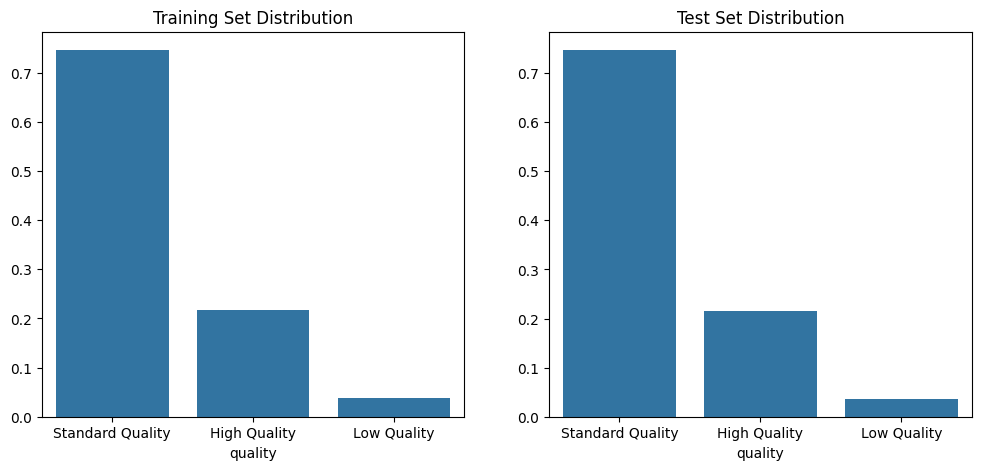

In [41]:
splits = [0.4, 0.6, 0.8, 0.9]

# Store the subsets
datasets = []

# Store the subsets
for split in splits:
    print(f"\n--- Train/Test Split: {int(split*100)}/{int((1-split)*100)} ---")
    feature_train, feature_test, label_train, label_test = split_and_visualize(X, y, split)
    datasets.append({
        "train_size": split,
        "feature_train": feature_train,
        "label_train": label_train,
        "feature_test": feature_test,
        "label_test": label_test
    })

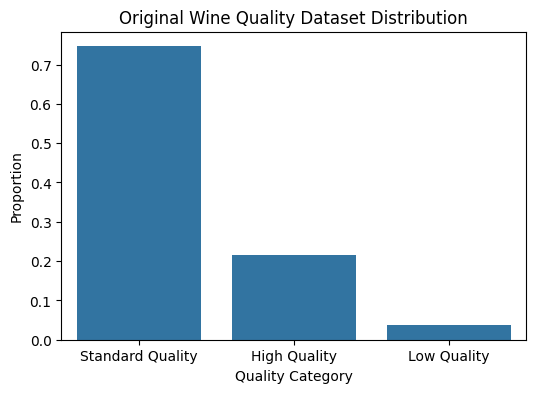

In [42]:
# Visualizing class distribution in the original dataset
original_dist = y.value_counts(normalize=True)
plt.figure(figsize=(6, 4))
sns.barplot(x=original_dist.index, y=original_dist.values)
plt.title("Original Wine Quality Dataset Distribution")
plt.xlabel("Quality Category")
plt.ylabel("Proportion")
plt.show()

### *Building the decision tree classifier*

In [43]:
# Define the folder where images will be saved
output_folder = "WQ_dataset_decision_trees"
os.makedirs(output_folder, exist_ok=True)  # Create the folder if it doesn't exist

In [44]:
def train_and_visualize_decision_tree(feature_train, label_train, train_size, output_folder) -> DecisionTreeClassifier:
    """
    Trains a DecisionTreeClassifier using information gain and visualizes it.
    
    Args:
        feature_train: Training features (DataFrame or ndarray)
        label_train: Training labels (pandas Series or ndarray)
        train_size: Size of the training dataset for title (float)
        output_folder: Folder to save the decision tree images
    
    Returns:
        clf: The trained decision tree classifier
    """
    # Ensure label_train is a pandas Series (not DataFrame or ndarray)
    if isinstance(label_train, pd.DataFrame):
        label_train = label_train.squeeze()  # Convert DataFrame to Series if needed

    # Initialize the classifier with entropy (information gain)
    clf = DecisionTreeClassifier(criterion='entropy', random_state=42)
    
    # Train the classifier on the feature_train and label_train
    clf.fit(feature_train, label_train)
    
    # Export the decision tree as DOT data (Graphviz format)
    dot_data = export_graphviz(
        clf,
        out_file=None,
        feature_names=feature_train.columns if isinstance(feature_train, pd.DataFrame) else [str(i) for i in range(feature_train.shape[1])],
        class_names=[str(c) for c in label_train.unique()],
        filled=True,
        rounded=True,
        special_characters=True
    )
    
    # Ensure output folder exists
    os.makedirs(output_folder, exist_ok=True)
    
    # Generate the decision tree image and save it
    image_path = os.path.join(output_folder, f"DecisionTree_{int(train_size * 100)}")
    graph = Source(dot_data)
    graph.render(image_path, format='png', cleanup=True)
    
    # Display the decision tree in the notebook
    display(Image(filename=image_path + ".png", width=1300))
    
    return clf

In [45]:
# Initialize an empty dictionary to store trained classifiers
trained_classifiers = {}
# Train and visualize decision trees for each split
for dataset in datasets:
    print(f"\n--- Training Decision Tree (Train size = {dataset['train_size']}) ---")
    # Store the trained classifier
    train_size_str = f"{dataset['train_size']:.2f}"  # Use formatted string for the train size
    trained_classifiers[train_size_str] = train_and_visualize_decision_tree(
        dataset['feature_train'],
        dataset['label_train'],
        dataset['train_size'],
        output_folder
    )


--- Training Decision Tree (Train size = 0.4) ---



--- Training Decision Tree (Train size = 0.6) ---



--- Training Decision Tree (Train size = 0.8) ---


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.962999 to fit



--- Training Decision Tree (Train size = 0.9) ---


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.794698 to fit


### *Evaluating the decision tree classifier*

In [46]:
def evaluate_decision_tree(clf, feature_test, label_test, train_size):
    """
    Evaluates the performance of a decision tree classifier on the test set.
    
    Args:
        clf: Trained decision tree classifier
        feature_test: Test features
        label_test: True test labels
        train_size: Size of the training dataset for title
    """
    # Make predictions on the test set
    predictions = clf.predict(feature_test)
    
    # Generate the classification report
    report = classification_report(label_test, predictions)
    print(f"Classification Report for Train Size = {train_size}:\n")
    print(report)
    
    # Generate the confusion matrix
    cm = confusion_matrix(label_test, predictions)
    
    # Visualize the confusion matrix using seaborn heatmap
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=label_test.unique(), yticklabels=label_test.unique())
    plt.title(f"Confusion Matrix (Train Size = {train_size})")
    plt.xlabel("Predicted")
    plt.ylabel("True")
    plt.show()
    plt.close()


--- Evaluating Decision Tree (Train size = 0.4) ---
Classification Report for Train Size = 0.4:

                  precision    recall  f1-score   support

    High Quality       0.52      0.53      0.53       636
     Low Quality       0.22      0.20      0.21       110
Standard Quality       0.83      0.83      0.83      2193

        accuracy                           0.74      2939
       macro avg       0.52      0.52      0.52      2939
    weighted avg       0.74      0.74      0.74      2939



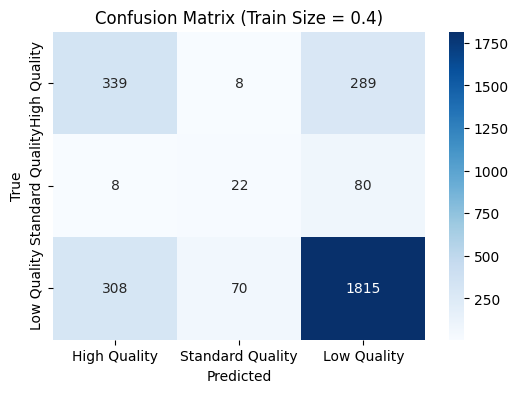


--- Evaluating Decision Tree (Train size = 0.6) ---
Classification Report for Train Size = 0.6:

                  precision    recall  f1-score   support

    High Quality       0.58      0.61      0.59       424
     Low Quality       0.29      0.33      0.31        73
Standard Quality       0.86      0.84      0.85      1463

        accuracy                           0.77      1960
       macro avg       0.58      0.59      0.58      1960
    weighted avg       0.78      0.77      0.78      1960



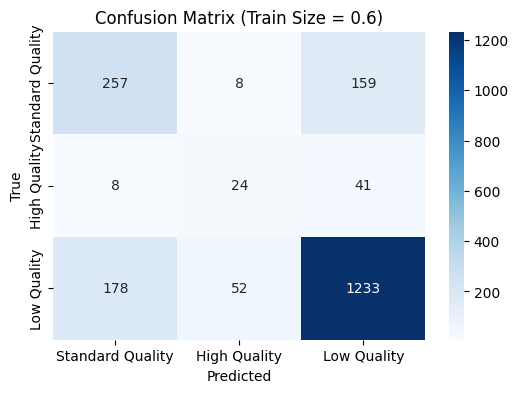


--- Evaluating Decision Tree (Train size = 0.8) ---
Classification Report for Train Size = 0.8:

                  precision    recall  f1-score   support

    High Quality       0.56      0.58      0.57       212
     Low Quality       0.42      0.41      0.41        37
Standard Quality       0.86      0.85      0.85       731

        accuracy                           0.78       980
       macro avg       0.61      0.61      0.61       980
    weighted avg       0.78      0.78      0.78       980



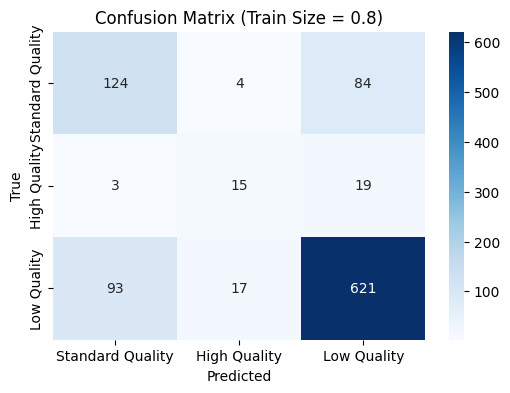


--- Evaluating Decision Tree (Train size = 0.9) ---
Classification Report for Train Size = 0.9:

                  precision    recall  f1-score   support

    High Quality       0.60      0.64      0.62       106
     Low Quality       0.39      0.39      0.39        18
Standard Quality       0.87      0.85      0.86       366

        accuracy                           0.79       490
       macro avg       0.62      0.63      0.62       490
    weighted avg       0.79      0.79      0.79       490



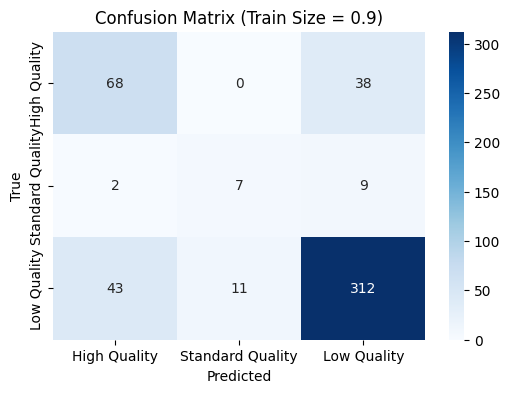

In [47]:
# Evaluate decision trees for each dataset split
for dataset in datasets:
    train_size_str = f"{dataset['train_size']:.2f}"  # Retrieve the key for the classifier
    clf = trained_classifiers[train_size_str]  # Retrieve the trained classifier
    
    # Evaluate the trained classifier on the test set
    print(f"\n--- Evaluating Decision Tree (Train size = {dataset['train_size']}) ---")
    evaluate_decision_tree(clf, dataset['feature_test'], dataset['label_test'], dataset['train_size'])

### *The depth and accuracy of a decision tree*

In [48]:
# Folder to save decision tree images for different depths
output_folder = "WQ_dataset_decision_trees/max_depth_trees"
os.makedirs(output_folder, exist_ok=True)

In [49]:
# Values for max_depth
depth_values = [None, 2, 3, 4, 5, 6, 7]
accuracy_results = []

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.962999 to fit


Decision Tree (max_depth=None):


Decision Tree (max_depth=2):


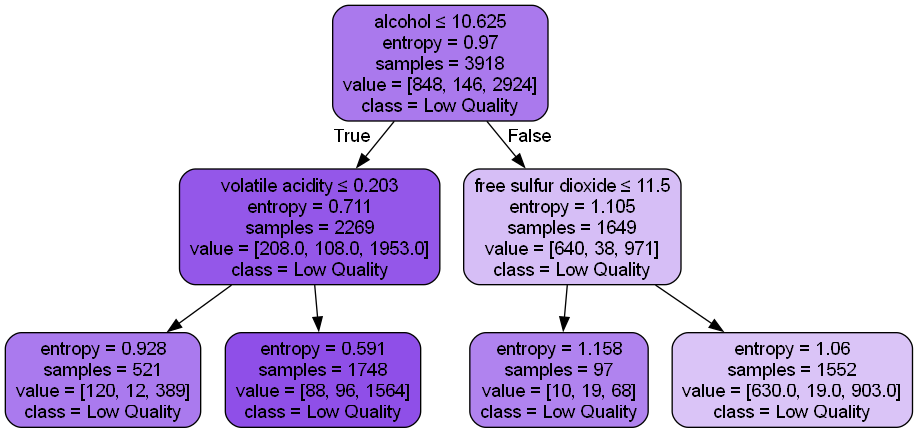

Decision Tree (max_depth=3):


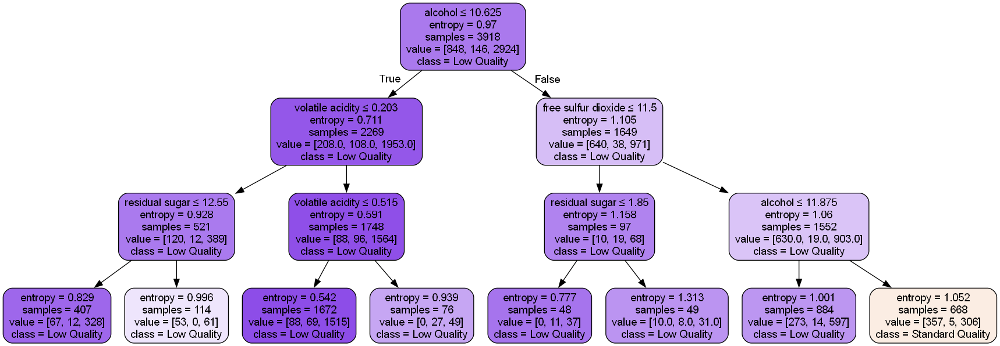

Decision Tree (max_depth=4):


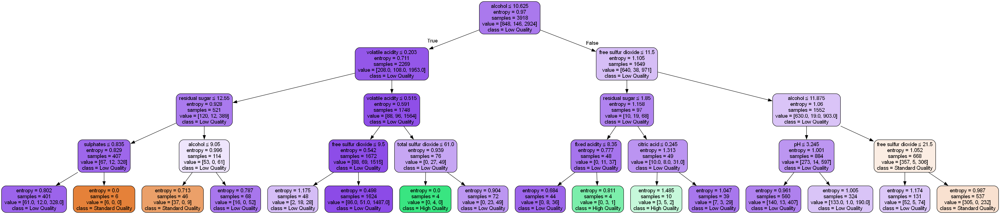

Decision Tree (max_depth=5):


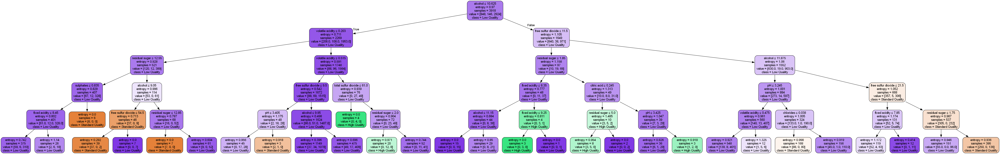

Decision Tree (max_depth=6):


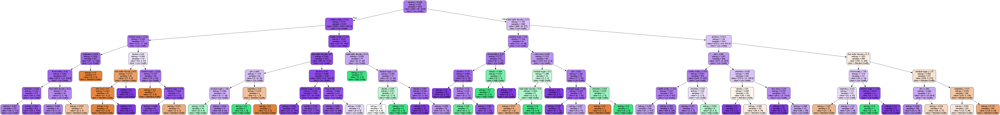

Decision Tree (max_depth=7):


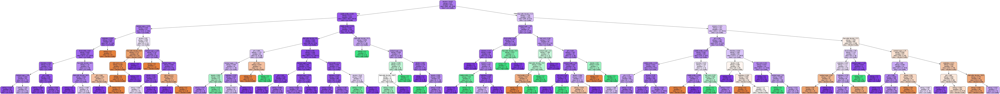

In [50]:
# Train and evaluate decision trees for different depths
dataset = None
for d in datasets:
    if d['train_size'] == 0.8:
        dataset = d
        break

# Ensure that we found the dataset with 80/20 split
if dataset is None:
    raise ValueError("No dataset found with 80/20 train-test split.")

for max_depth in depth_values:
    # Train the decision tree
    clf = DecisionTreeClassifier(criterion="entropy", random_state=42, max_depth=max_depth)
    clf.fit(dataset['feature_train'], dataset['label_train'])  # Train using current dataset

    # Predict and calculate accuracy
    predictions = clf.predict(dataset['feature_test'])
    accuracy = accuracy_score(dataset['label_test'], predictions)
    accuracy_results.append(accuracy)
    
    # Visualize the decision tree
    dot_data = export_graphviz(
        clf,
        out_file=None,
        feature_names=dataset['feature_train'].columns,
        class_names=dataset['label_train'].unique().astype(str),
        filled=True,
        rounded=True,
        special_characters=True
    )
    graph = Source(dot_data)
    image_path = os.path.join(output_folder, f"DecisionTree_maxDepth_{max_depth}")
    graph.render(image_path, format='png', cleanup=True)

    # Display the tree in the notebook
    print(f"Decision Tree (max_depth={max_depth}):")
    display(Image(filename=image_path + ".png", width=1300))

In [51]:
# Create a table of accuracies for each max_depth value
accuracy_table = pd.DataFrame({
    "max_depth": ["None" if d is None else d for d in depth_values],
    "Accuracy": accuracy_results
})
display(accuracy_table)

,max_depth,Accuracy
0,None,0.775510
1,2,0.745918
2,3,0.761224
3,4,0.772449
4,5,0.781633
5,6,0.786735
6,7,0.787755


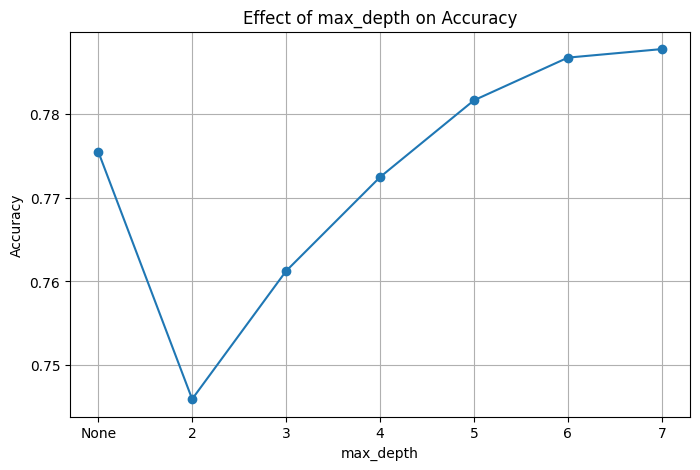

In [52]:
# Plot accuracy scores for different max_depth values
plt.figure(figsize=(8, 5))
plt.plot(["None" if d is None else d for d in depth_values], accuracy_results, marker="o")
plt.title("Effect of max_depth on Accuracy")
plt.xlabel("max_depth")
plt.ylabel("Accuracy")
plt.grid(True)
plt.show()